In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scirpy as ir
from matplotlib import pyplot as plt, cm as mpl_cm
from cycler import cycler

sc.set_figure_params(figsize=(4, 4))
sc.settings.verbosity = 2  # verbosity: errors (0), warnings (1), info (2), hints (3)

In [2]:
sc.logging.print_header()

scanpy==1.9.3 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.10.1 pandas==1.5.3 scikit-learn==1.0 statsmodels==0.13.5 python-igraph==0.10.4 louvain==0.8.0 pynndescent==0.5.8


In [3]:
import warnings

warnings.filterwarnings(
    "ignore",
    ".*IProgress not found*",
)
warnings.simplefilter(action="ignore", category=FutureWarning)

warnings.simplefilter(action="ignore", category=pd.errors.DtypeWarning)

In [4]:
import rpy2.robjects as robjects
from rpy2.robjects.packages import importr
## r2py setup
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

anndata2ri.activate()
%load_ext rpy2.ipython


In [5]:
import os
os.chdir("/home/maolp/data5/Gaofeng_All_matrix/Allcount/")

In [6]:
adata1=sc.read_h5ad("./All_scanpyData/Data/Scanpy_merge_rmdoubulet_UMAP_label_lastCell.h5ad")

In [7]:
adata1

AnnData object with n_obs × n_vars = 245834 × 31424
    obs: 'Name', 'doublet_scores', 'predicted_doublets', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Cellname', 'AdjustedID', 'New_Body', 'Week', 'TCRBCRlabel', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Last_cell_type', 'Cell_lineage', 'Last_cell_type2', 'Last_cell_type_num', 'Last_cell_type_num2'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'AdjustedID_colors', 'Cell_lineage_colors', 'Last_cell_type_num_colors', 'New_Body_colors', 'TCRBCRlabel_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'majority_voting_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [8]:
%%R -w 500 -h 300 

BCRdir="/data1/maolp/Rstudy/GaofengSinglecell/Gaofeng_All_matrix/Allcount/BCR_all/"
BCRsamples=list.files(path = BCRdir,"csv")
AllBCR=data.frame()
for (line in BCRsamples) {
#   print(line)
  name=gsub("_BCR_filtered_contig_annotations.csv","",line)
  print(name)
  if (!name %in% c("Z28")){
     Test_BCR<-read.csv(file.path(BCRdir,line))
     Test_BCR$barcodename=paste0(name,"_",Test_BCR$barcode)
     Test_BCR$Group<-name
     AllBCR=rbind(AllBCR,Test_BCR)
  }
 
}
head(AllBCR)

[1] "B25"
[1] "B9"
[1] "C10"
[1] "C25"
[1] "C27"
[1] "C36"
[1] "D25"
[1] "D27"
[1] "D36"
[1] "D9"
[1] "Z03"
[1] "Z07"
[1] "z104"
[1] "Z123"
[1] "Z28"
[1] "Z33"
[1] "Z36"
[1] "Z38"
[1] "Z42"
[1] "Z43"
[1] "Z47"
[1] "Z48"
[1] "Z50"
[1] "Z52"
[1] "Z53"
[1] "Z67"
[1] "Z70"
[1] "Z77"
[1] "Z79"
[1] "Z96"
[1] "Z98"
[1] "Z99"
             barcode is_cell                   contig_id high_confidence length
1 AAACCTGAGATGTGGC-1    true AAACCTGAGATGTGGC-1_contig_1            true    648
2 AAACCTGAGATGTGGC-1    true AAACCTGAGATGTGGC-1_contig_2            true    565
3 AAACCTGAGATGTGGC-1    true AAACCTGAGATGTGGC-1_contig_3            true    555
4 AAACCTGAGGCAGGTT-1    true AAACCTGAGGCAGGTT-1_contig_1            true    571
5 AAACCTGAGGCAGGTT-1    true AAACCTGAGGCAGGTT-1_contig_2            true    550
6 AAACCTGAGGCGCTCT-1    true AAACCTGAGGCGCTCT-1_contig_1            true    551
  chain   v_gene d_gene j_gene c_gene full_length productive
1   IGL IGLV2-14         IGLJ3  IGLC3        true       tru

In [9]:
%%R
getwd()
write.csv(AllBCR,"/data5/maolp/Gaofeng_All_matrix/Allcount/All_scanpyData/BCRTCR/Gao_All_BCR.csv")

In [10]:
path_data = "/data5/maolp/Gaofeng_All_matrix/Allcount/All_scanpyData/BCRTCR/"
path_bcr_input = f"{path_data}/Gao_All_BCR.csv"
# path_tcr_input = f"{path_data}/Gao_All_TCR.csv"

In [11]:
path_bcr_csv = f"{path_data}/BCR_read_aligned.csv"
path_bcr_out = f"{path_data}/BCR_preprocessed.h5ad"


In [12]:
df_bcr_raw = pd.read_csv(path_bcr_input, index_col=0)

# The column 'productive' contains mixed data types which are not compatible with downstream tools.
# We correct them by casting them to strings.
df_bcr_raw["productive"] = df_bcr_raw["productive"].astype(str)
df_bcr_raw["barcode"] =df_bcr_raw["barcodename"]
print(f"Total measurements: {len(df_bcr_raw)}")
df_bcr_raw.head(5)
df_bcr_raw.to_csv(path_bcr_csv)

Total measurements: 81575


In [13]:
df_bcr_raw["productive"].unique()

array(['True'], dtype=object)

In [14]:
adata_bcr = ir.io.read_10x_vdj(path_bcr_csv)
print(f"Amount cells: {len(adata_bcr)}")

Amount cells: 39980


In [15]:
adata_bcr.obs['IR_VDJ_1_junction_aa']

cell_id
B25_AAACCTGAGATGTGGC-1       CARKRRINWGLRNGAFDIW
B25_AAACCTGAGGCAGGTT-1          CARAVPNWNYDAFDIW
B25_AAACCTGAGGCGCTCT-1          CARGYKPYHKYYFDYW
B25_AAACCTGAGGGAACGG-1            CARALTTLGYFDYW
B25_AAACCTGCATGAACCT-1            CARVPNWGSAFDIW
                                   ...          
z104_TTTGCGCTCATCGCTC-1        CAKGVITGDADWYFDLW
z104_TTTGGTTGTGTGTGCC-1               CARAPEFDYW
z104_TTTGGTTTCACTCCTG-1    CARRDRVGIASDIVYWYFDLW
z104_TTTGGTTTCTGGCGTG-1               CARDRRNYYW
z104_TTTGTCAGTGTGTGCC-1         CARGQGKSPTYYFDYW
Name: IR_VDJ_1_junction_aa, Length: 39980, dtype: category
Categories (38595, object): ['CAAAARPGDAFDIW', 'CAAAGYSSSYYYYYGMDVW', 'CAAAHNWNYGGAFDIW', 'CAAALELTGDYYGMDVW', ..., 'CYLYYDFWSGHDAFDIW', 'CYNLGYCSSTSCYDAFDIW', 'CYSGGHDYW', 'CYTIFGVVKKNWYFDLW']

In [16]:
ir.pp.merge_with_ir(adata1, adata_bcr)

In [17]:
adata_bcr2=adata_bcr
import pandas as pd


BCRmerged_obs = adata_bcr2.obs.merge(adata1.obs, left_index=True, right_index=True, how='left', suffixes=('', '_y'))

adata_bcr2.obs = BCRmerged_obs

In [18]:
ir.tl.chain_qc(adata_bcr2)
ir.tl.chain_qc(adata1)

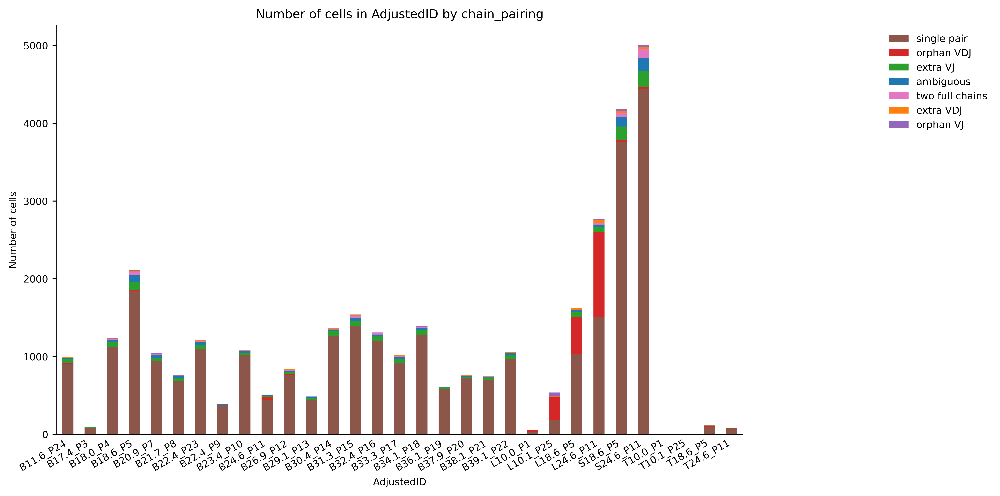

In [19]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300

_ = ir.pl.group_abundance(adata_bcr2, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical",fig_kws={"figsize": (10, 6)})


In [20]:
# adata1
adata_bcr2.obs.to_csv("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure3/Data/AllBCR_withorphan.csv")

In [21]:
mkdir -p /home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/BCRFigure

In [22]:
abundance_AdjustedID=ir.tl.group_abundance(
    adata_bcr2, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical"
)

In [23]:
%%R -i  abundance_AdjustedID -w 1000 -h 600
library(tidyverse)
library(ggplot2)
library(ggsci)

# plot_proportions <- function(data, output_file) {
  data_prop <- abundance_AdjustedID %>% rownames_to_column(var = "tissue") %>%
    mutate(total = rowSums(.[, -1])) 
  data_prop

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.1     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.4.3     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.1     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
      tissue single pair orphan VDJ extra VJ ambiguous two full chains
1  B11.6_P24         906          9       51        15               3
2   B17.4_P3          84          0        5         1               1
3   B18.0_P4        1120          3       60        28              14
4   B18.6_P5        1847         13      101        81              42
5   B20.9_P7         938          5       42        30              17
6   B21.7_P8         678          8       33      

In [24]:
%%R
source("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_script_in_save/color.R")

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


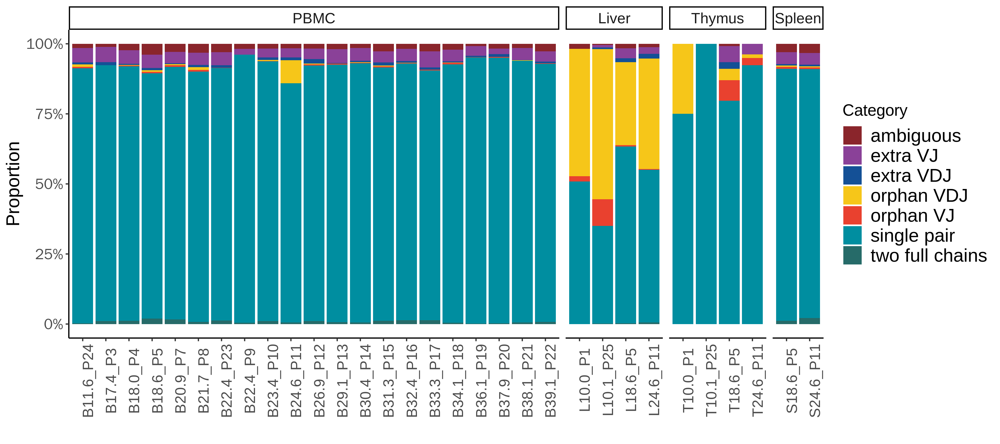

In [25]:
%%R -i  abundance_AdjustedID -w 3600 -h 1600 -r 300
library(tidyverse)
library(ggplot2)
library(ggsci)

# plot_proportions <- function(data, output_file) {
  data_prop <- abundance_AdjustedID %>% rownames_to_column(var = "tissue") %>%
    mutate(total = rowSums(.[, -1])) %>%

    mutate(across(starts_with("single") | starts_with("orphan") | starts_with("extra") |  starts_with("ambiguous") | 
                  starts_with("two"), ~ . / total, .names = "prop_{.col}"))
  data_prop 
  data_long <- data_prop %>%
    select(tissue, starts_with("prop")) %>%
    pivot_longer(cols = starts_with("prop"),
                 names_to = "category",
                 values_to = "proportion") %>%
    mutate(category = str_remove(category, "prop_"))
  data_long
#   data_long$tissue <- factor(data_long$tissue, level = c('PBMC', 'Liver', 'Thymus', 'Spleen'))
  library(dplyr)
library(stringr)

data_long$Organ <- str_sub(data_long$tissue, 1, 1)

# 将首字母转换为完整的组织名称
data_long <- data_long %>%
  mutate(Organ = case_when(
    Organ == "B" ~ "PBMC",
    Organ == "L" ~ "Liver",
    Organ == "S" ~ "Spleen",
    Organ == "T" ~ "Thymus"
  ))
data_long$Organ<-factor(data_long$Organ,level=c('PBMC','Liver','Thymus','Spleen'))
data_long$category<-factor(data_long$category,levels=c("ambiguous","extra VJ",
"extra VDJ",
"orphan VDJ","orphan VJ",
"single pair",
"two full chains"
))

Ppcen_sample <- ggplot(data_long, aes(x = tissue, y = proportion, fill = category)) +
  geom_col() +
  scale_y_continuous(labels = scales::percent) +
  labs(x = "Tissue", y = "Proportion", fill = "Category") +
  theme_classic() +
  xlab('') +
  theme(text = element_text(size = 16),
        legend.position = "right",
        legend.title = element_text(size = 14),
        legend.text = element_text(size = 16),
        axis.text.x = element_text(angle = 90)) +
  scale_fill_d3() +scale_fill_manual(values=col11)+
    facet_grid(. ~ Organ, space = "free", scales = "free", switch = "y")  # 使用 Organ 列进行分面显示

write.csv( data_long,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure3/Data/Figure3A_BCRF2_allsamplepercentage.csv")
print(Ppcen_sample)
 Ppcen_sample 
ggsave(plot = Ppcen_sample, filename ='/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure3/Figure3A_BCRF2_allsamplepercentage.pdf', width = 12, height = 5)
  
#   return(Ppcen)
# }

# 使用函数绘制图像并保存为 PDF
# plot_proportions(abundance_AdjustedID, "/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/BCRFigure/BCRF2_allsamplepercentage.pdf")


In [26]:
mkdir -p /home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure3/Data

In [73]:
%%R
head(data_long)

Lpo=data_long[grep("L",data_long$Organ),]%>%.[grep("single",.$category),]
mean_proportion <- mean(Lpo$proportion, na.rm = TRUE)
se_proportion <- sd(Lpo$proportion, na.rm = TRUE) / sqrt(sum(!is.na(Lpo$proportion)))

# 输出均值和标准误
cat("Mean:", mean_proportion, "\n")
cat("Standard Error:", se_proportion, "\n")
Lpo

Mean: 0.5083519 
Standard Error: 0.05920982 
# A tibble: 4 × 4
  tissue    category    proportion Organ
  <chr>     <fct>            <dbl> <fct>
1 L10.0_P1  single pair      0.509 Liver
2 L10.1_P25 single pair      0.348 Liver
3 L18.6_P5  single pair      0.631 Liver
4 L24.6_P11 single pair      0.545 Liver


In [70]:
%%R
# 定义数据框
Lpo <- data.frame(
  tissue = c("L10.0_P1", "L10.1_P25", "L18.6_P5", "L24.6_P11"),
  category = factor(c("single pair", "single pair", "single pair", "single pair")),
  proportion = c(0.509, 0.348, 0.631, 0.545),
  Organ = factor(c("Liver", "Liver", "Liver", "Liver"))
)

# 计算均值
mean_proportion <- mean(Lpo$proportion, na.rm = TRUE)

# 计算标准误
se_proportion <- sd(Lpo$proportion, na.rm = TRUE) / sqrt(length(Lpo$proportion))

# 输出均值和标准误
cat("Mean:", mean_proportion, "\n")
cat("Standard Error:", se_proportion, "\n")

Mean: 0.50825 
Standard Error: 0.05923031 


In [72]:
%%R
Lpo <- data.frame(
  tissue = c("L10.0_P1", "L10.1_P25", "L18.6_P5", "L24.6_P11"),
  category = factor(c("single pair", "single pair", "single pair", "single pair")),
  proportion = c(0.509, 0.348, 0.631, 0.545),
  Organ = factor(c("Liver", "Liver", "Liver", "Liver"))
)

# 计算均值
mean_proportion <- median(Lpo$proportion, na.rm = TRUE)

# 计算标准误
se_proportion <- sd(Lpo$proportion, na.rm = TRUE) / sqrt(length(Lpo$proportion))

# 输出均值和标准误
cat("Mean:", mean_proportion, "\n")
cat("Standard Error:", se_proportion, "\n")

Mean: 0.527 
Standard Error: 0.05923031 


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


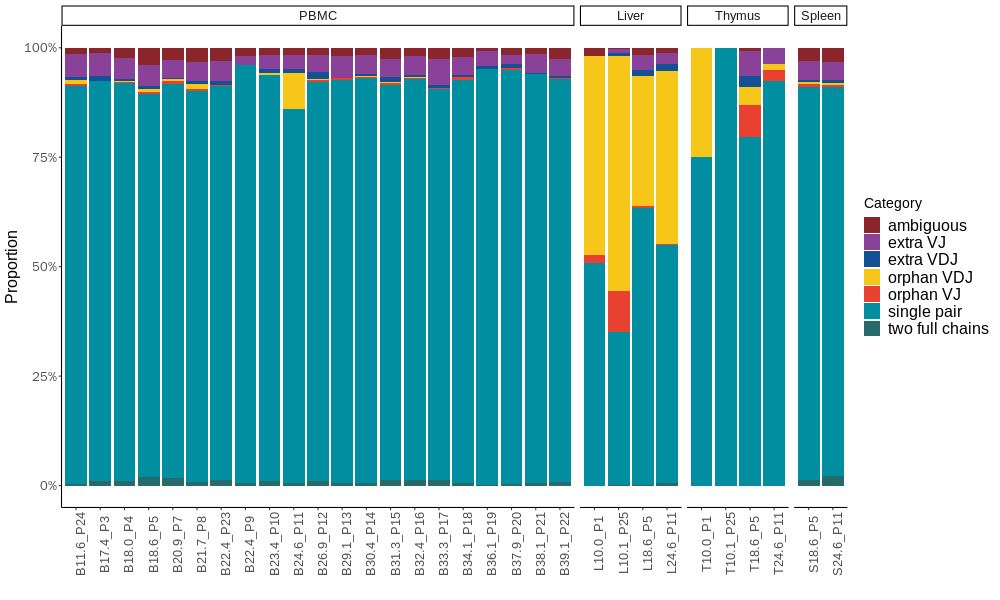

In [28]:
%%R -i  abundance_AdjustedID -w 1000 -h 600
library(tidyverse)
library(ggplot2)
library(ggsci)

# plot_proportions <- function(data, output_file) {
  data_prop <- abundance_AdjustedID %>% rownames_to_column(var = "tissue") %>%
    mutate(total = rowSums(.[, -1])) %>%

    mutate(across(starts_with("single") | starts_with("orphan") | starts_with("extra") |  starts_with("ambiguous") | 
                  starts_with("two"), ~ . / total, .names = "prop_{.col}"))
  data_prop 
  data_long <- data_prop %>%
    select(tissue, starts_with("prop")) %>%
    pivot_longer(cols = starts_with("prop"),
                 names_to = "category",
                 values_to = "proportion") %>%
    mutate(category = str_remove(category, "prop_"))
  data_long
#   data_long$tissue <- factor(data_long$tissue, level = c('PBMC', 'Liver', 'Thymus', 'Spleen'))
  library(dplyr)
library(stringr)

data_long$Organ <- str_sub(data_long$tissue, 1, 1)

data_long <- data_long %>%
  mutate(Organ = case_when(
    Organ == "B" ~ "PBMC",
    Organ == "L" ~ "Liver",
    Organ == "S" ~ "Spleen",
    Organ == "T" ~ "Thymus"
  ))
data_long$Organ<-factor(data_long$Organ,level=c('PBMC','Liver','Thymus','Spleen'))
data_long$category<-factor(data_long$category,levels=c("ambiguous","extra VJ",
"extra VDJ",
"orphan VDJ","orphan VJ",
"single pair",
"two full chains"
))
Ppcen_sample <- ggplot(data_long, aes(x = tissue, y = proportion, fill = category)) +
  geom_col() +
  scale_y_continuous(labels = scales::percent) +
  labs(x = "Tissue", y = "Proportion", fill = "Category") +
  theme_classic() +
  xlab('') +
  theme(text = element_text(size = 16),
        legend.position = "right",
        legend.title = element_text(size = 14),
        legend.text = element_text(size = 16),
        axis.text.x = element_text(angle = 90)) +
  scale_fill_d3() +scale_fill_manual(values=col11)+
    facet_grid(. ~ Organ, space = "free", scales = "free", switch = "y") 


print(Ppcen_sample)
 Ppcen_sample 
  ggsave(plot = Ppcen_sample, filename ='/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure5/Figure5A_BCRF2_allsamplepercentage.pdf', width = 12, height = 5)
  
#   return(Ppcen)
# }


# plot_proportions(abundance_AdjustedID, "/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/BCRFigure/BCRF2_allsamplepercentage.pdf")


In [29]:
abundance_Organcount=ir.tl.group_abundance(
    adata_bcr2, groupby="New_Body", target_col="chain_pairing", sort="alphabetical"
)
# abundance_AdjustedIDcount

In [30]:
abundance_AdjustedIDcount=ir.tl.group_abundance(
    adata_bcr2, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical"
)
# abundance_AdjustedIDcount

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


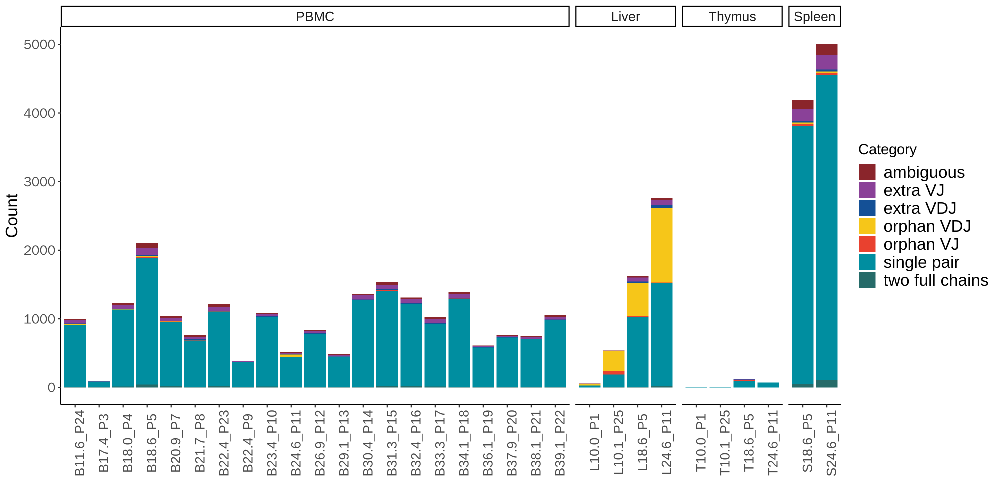

In [31]:
%%R -i  abundance_Organcount -w 4000 -h 2000 -r 300 -i abundance_AdjustedIDcount
library(tidyverse)
library(reshape)
abundance_AdjustedIDcount$Sample<-rownames(abundance_AdjustedIDcount)
# rownames_to_collumn(abundance_AdjustedIDcount)
# melt(abundance_AdjustedIDcount)
abundance_AdjustedIDcount2<-melt(abundance_AdjustedIDcount,id.vars=c('Sample'))
abundance_AdjustedIDcount2$Organ <- str_sub(abundance_AdjustedIDcount2$Sample, 1, 1)
abundance_AdjustedIDcount2<- abundance_AdjustedIDcount2 %>%
  mutate(Organ = case_when(
    Organ == "B" ~ "PBMC",
    Organ == "L" ~ "Liver",
    Organ == "S" ~ "Spleen",
    Organ == "T" ~ "Thymus"
  ))
abundance_AdjustedIDcount2$Organ<-factor(abundance_AdjustedIDcount2$Organ,level=c('PBMC','Liver','Thymus','Spleen'))
abundance_AdjustedIDcount2$variable<-factor(abundance_AdjustedIDcount2$variable,levels=c("ambiguous","extra VJ",
"extra VDJ",
"orphan VDJ","orphan VJ",
"single pair",
"two full chains"
))
P555=ggplot(abundance_AdjustedIDcount2, aes(x = Sample, y = value, fill =variable)) +
  geom_col() +
#   scale_y_continuous(labels = scales::percent) +
  labs(x = "Tissue", y = "Count", fill = "Category") +
  theme_classic() +
  xlab('') +
  theme(text = element_text(size = 16),
        legend.position = "right",
        legend.title = element_text(size = 14),
        legend.text = element_text(size = 16),
        axis.text.x = element_text(angle = 90)) +
  scale_fill_d3() +scale_fill_manual(values=col11)+
    facet_grid(. ~ Organ, space = "free", scales = "free", switch = "y")  # 使用 Organ 列进行分面显示
write.csv( abundance_AdjustedIDcount2,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure3/Data/S33_FigureA_BCRF2_allsample.csv")
  ggsave(plot =P555 , filename ='/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure5/S33/S33_FigureA_BCRF2_allsample.pdf', width = 12, height = 5)
P555

In [32]:
# %%R


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


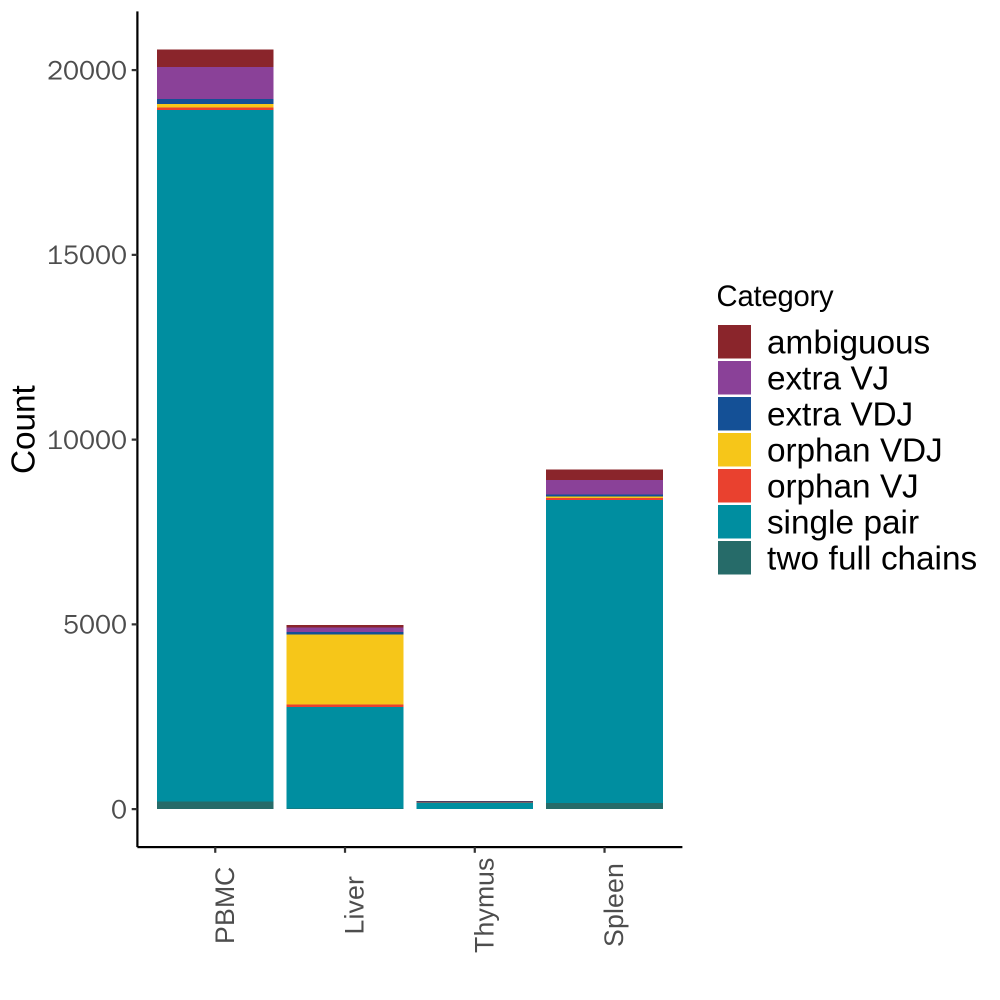

In [33]:
%%R -i  abundance_Organcount -w 2000 -h 2000 -r 300
abundance_Organcount$Sample<-rownames(abundance_Organcount)
# rownames_to_collumn(abundance_Organcount)
# melt(abundance_Organcount)
abundance_Organcount2<-melt(abundance_Organcount,id.vars=c('Sample'))
# abundance_Organcount2$Organ <- str_sub(abundance_Organcount2$Sample, 1, 1)
# abundance_Organcount2<- abundance_Organcount2 %>%
#   mutate(Organ = case_when(
#     Organ == "B" ~ "PBMC",
#     Organ == "L" ~ "Liver",
#     Organ == "S" ~ "Spleen",
#     Organ == "T" ~ "Thymus"
#   ))
abundance_Organcount2$Sample<-factor(abundance_Organcount2$Sample,level=c('PBMC','Liver','Thymus','Spleen'))
abundance_Organcount2$variable<-factor(abundance_Organcount2$variable,levels=c("ambiguous","extra VJ",
"extra VDJ",
"orphan VDJ","orphan VJ",
"single pair",
"two full chains"
))
P666=ggplot(abundance_Organcount2, aes(x =Sample, y = value, fill =variable)) +
  geom_col() +
#   scale_y_continuous(labels = scales::percent) +
  labs(x = "Tissue", y = "Count", fill = "Category") +
  theme_classic() +
  xlab('') +
  theme(text = element_text(size = 16),
        legend.position = "right",
        legend.title = element_text(size = 14),
        legend.text = element_text(size = 16),
        axis.text.x = element_text(angle = 90)) +
  scale_fill_d3() +scale_fill_manual(values=col11)
 ggsave(plot =P666 , filename ='/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure5/S33/S33_FigureA_BCRF2_allsamplesum.pdf', width = 12, height = 5)
P666

In [34]:
%%R
write.csv(abundance_Organcount2,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure3/Data/S33_FigureA_BCRF2_allsamplesum.csv")

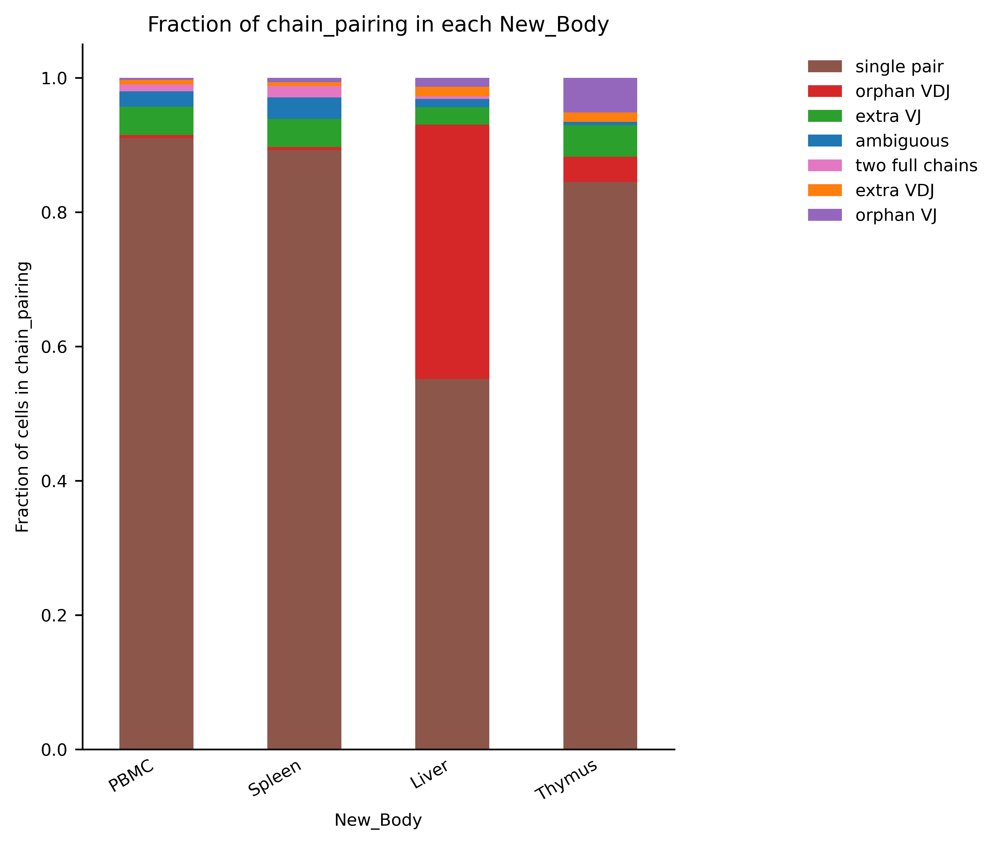

In [35]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300

_ = ir.pl.group_abundance(adata_bcr2, groupby="New_Body", target_col="chain_pairing", normalize=True,fig_kws={"figsize": (5, 6)})

# .obs['Centre'].value_counts()

In [36]:
testabundance = ir.tl.group_abundance(
    adata_bcr, groupby="New_Body", target_col="chain_pairing", sort="alphabetical"
)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


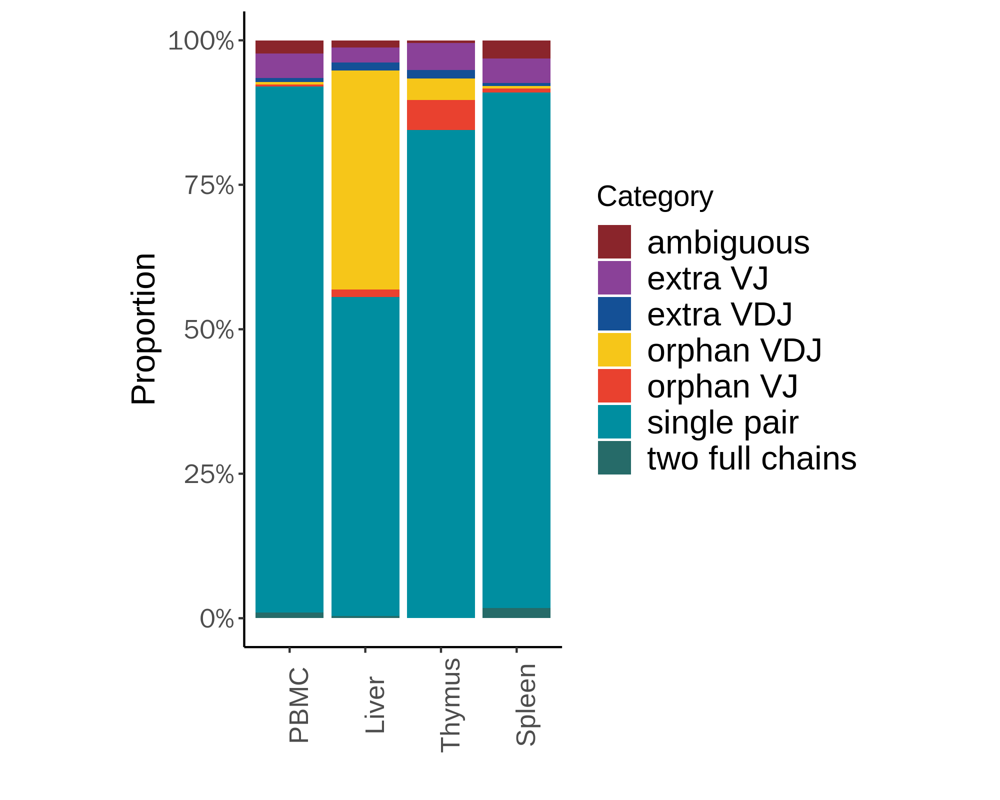

In [89]:
%%R -i testabundance -w 2000 -h 1600 -r 300
library(tidyverse)
library(ggplot2)
library(ggsci)

plot_proportions <- function(data, output_file) {
  data_prop <- data %>% rownames_to_column(var = "tissue") %>%
    mutate(total = rowSums(.[, -1])) %>%
      mutate(across(starts_with("single") | starts_with("orphan") | starts_with("extra") |  starts_with("ambiguous") | 
                  starts_with("two"), ~ . / total, .names = "prop_{.col}"))
  data_long <- data_prop %>%
    select(tissue, starts_with("prop")) %>%
    pivot_longer(cols = starts_with("prop"),
                 names_to = "category",
                 values_to = "proportion") %>%
    mutate(category = str_remove(category, "prop_"))
  
  data_long$tissue <- factor(data_long$tissue, level = c('PBMC', 'Liver', 'Thymus', 'Spleen'))
  data_long$category<-factor(data_long$category,levels=c("ambiguous","extra VJ",
"extra VDJ",
"orphan VDJ","orphan VJ",
"single pair",
"two full chains"
))
  Ppcen <- ggplot(data_long, aes(x = tissue, y = proportion, fill = category)) +
    geom_col() +
    scale_y_continuous(labels = scales::percent) +
    labs(x = "Tissue", y = "Proportion", fill = "Category") +
    theme_classic() +
    xlab('') +
    theme(text = element_text(size = 16),
          legend.position = "right",
          legend.title = element_text(size = 14),
          legend.text = element_text(size = 16),
          axis.text.x=element_text(angle=90),
         aspect.ratio = 2) +
    scale_fill_d3()+scale_fill_manual(values=col11)
  
  ggsave(plot = Ppcen, filename = output_file, width = 6, height = 5)
  write.csv(data_long,"/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure3/Data/Figure5B_BCR_sumVDJ.csv")
  return(Ppcen)
}


plot_proportions(testabundance, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure5/Figure5B_BCR_sumVDJ.pdf")

In [91]:

%%R -i testabundance -w 2000 -h 1600 -r 300
library(tidyverse)
library(ggplot2)
library(ggsci)

plot_proportions <- function(data, output_file) {
  data_prop <- data %>% rownames_to_column(var = "tissue") %>%
    mutate(total = rowSums(.[, -1])) %>%
      mutate(across(starts_with("single") | starts_with("orphan") | starts_with("extra") |  starts_with("ambiguous") | 
                  starts_with("two"), ~ . / total, .names = "prop_{.col}"))
  data_long <- data_prop %>%
    select(tissue, starts_with("prop")) %>%
    pivot_longer(cols = starts_with("prop"),
                 names_to = "category",
                 values_to = "proportion") %>%
    mutate(category = str_remove(category, "prop_"))
  
  data_long$tissue <- factor(data_long$tissue, level = c('PBMC', 'Liver', 'Thymus', 'Spleen'))
  data_long$category<-factor(data_long$category,levels=c("ambiguous","extra VJ",
"extra VDJ",
"orphan VDJ","orphan VJ",
"single pair",
"two full chains"
))
  
  return(  data_prop)
}


test1=plot_proportions(testabundance, "/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure5/Figure5B_BCR_sumVDJ.pdf")

In [92]:
%%R
test1

  tissue single pair orphan VDJ extra VJ ambiguous two full chains extra VDJ
1  Liver        2748       1887      130        62              20        70
2   PBMC       18712         97      870       470             207       139
3 Spleen        8205         41      386       291             160        49
4 Thymus         180          8       10         1               0         3
  orphan VJ total prop_single pair prop_orphan VDJ prop_orphan VJ prop_extra VJ
1        66  4983        0.5514750     0.378687538    0.013245033    0.02608870
2        65 20560        0.9101167     0.004717899    0.003161479    0.04231518
3        61  9193        0.8925269     0.004459915    0.006635484    0.04198847
4        11   213        0.8450704     0.037558685    0.051643192    0.04694836
  prop_extra VDJ prop_ambiguous prop_two full chains
1    0.014047762    0.012442304          0.004013646
2    0.006760700    0.022859922          0.010068093
3    0.005330142    0.031654520          0.017404547
4  

In [39]:
col11=["#8a252b","#8A4198FF",  "#145096","#f6c619","#e9412f", "#008EA0FF", 
 "#266b69", "#3178a2"]
def create_palette(cell_types, colors):
    cell_type_colors = {}
    for i, cell_type in enumerate(cell_types):
        color = colors[i % len(colors)]
        cell_type_colors[cell_type] = color
    return cell_type_colors

colorname2=["#868686", "#B5AD64","#9DA8E2","#46A040" ,"#00AF99", "#FFC179" ,"#98D9E9" ,"#F6313E", "#FFA300", "#333366", "#FF5A00", "#663366","#FF6666",
"#8F1336", "#0081C9", "#001588", "#CC0033","#CC9966","#CC0033","#999933","#009966","#CCCC33","#CCFF99","#333399","#993333",
"#490C65", "#BA7FD0","#A6CEE3", "#1F78B4", "#DE77AE", "#B2DF8A", "#006D2C", "#91C392","#FF9900","#339966","#46A040" ,"#00AF99", "#FFC179" ,"#98D9E9" ,"#F6313E"]

In [40]:
adata1_IR = adata1[adata1.obs['chain_pairing'] != 'no IR']
ir.tl.chain_qc(adata1_IR)

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scirpy/tl/_chain_qc.py:162: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[col_receptor_type] = res_receptor_type


In [41]:
pal={'single pair': '#008EA0FF',
 'ambiguous':'#8a252b' ,
 'two full chains': '#266b69',
 'extra VJ': '#8A4198FF',
 'extra VDJ': '#145096',
 'orphan VDJ': '#f6c619',
 'orphan VJ': '#e9412f'}

In [42]:
create_palette(adata1_IR.obs["chain_pairing"].unique(),col11)

{'single pair': '#8a252b',
 'ambiguous': '#8A4198FF',
 'two full chains': '#145096',
 'extra VJ': '#f6c619',
 'extra VDJ': '#e9412f',
 'orphan VDJ': '#008EA0FF',
 'orphan VJ': '#266b69'}

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


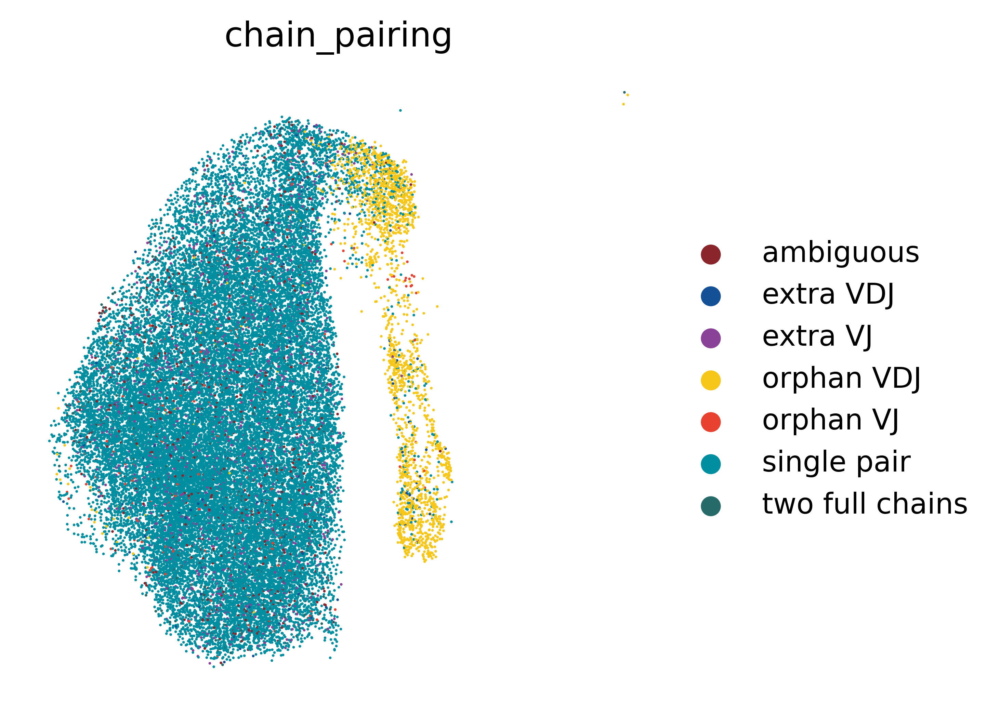

In [43]:
sc.pl.umap(adata1_IR, color="chain_pairing",palette=pal,frameon=False,show=False)
plt.savefig("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure5/Figure5C_BCR_allVDJ.pdf",bbox_inches='tight')

In [44]:
def cluster_small_multiples(
    adata, clust_key, size=60, frameon=False, legend_loc=None, **kwargs
):
    tmp = adata.copy()

    for i, clust in enumerate(adata.obs[clust_key].cat.categories):
        tmp.obs[clust] = adata.obs[clust_key].isin([clust]).astype("category")
        tmp.uns[clust + "_colors"] = ["#d3d3d3", adata.uns[clust_key + "_colors"][i]]

    sc.pl.umap(
    tmp,
    groups=tmp.obs[clust].cat.categories[1:].values,
    color=adata.obs[clust_key].cat.categories.tolist(),
    size=size,
    frameon=frameon,
    legend_loc=legend_loc,
    show=False,
    **kwargs
)

In [45]:

pal={'extra VDJ': '#145096',
 'single pair': '#008EA0FF',
 'orphan VDJ': '#f6c619',
 'extra VJ': '#8A4198FF',
 'two full chains': '#266b69',
 'orphan VJ': '#e9412f'}

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


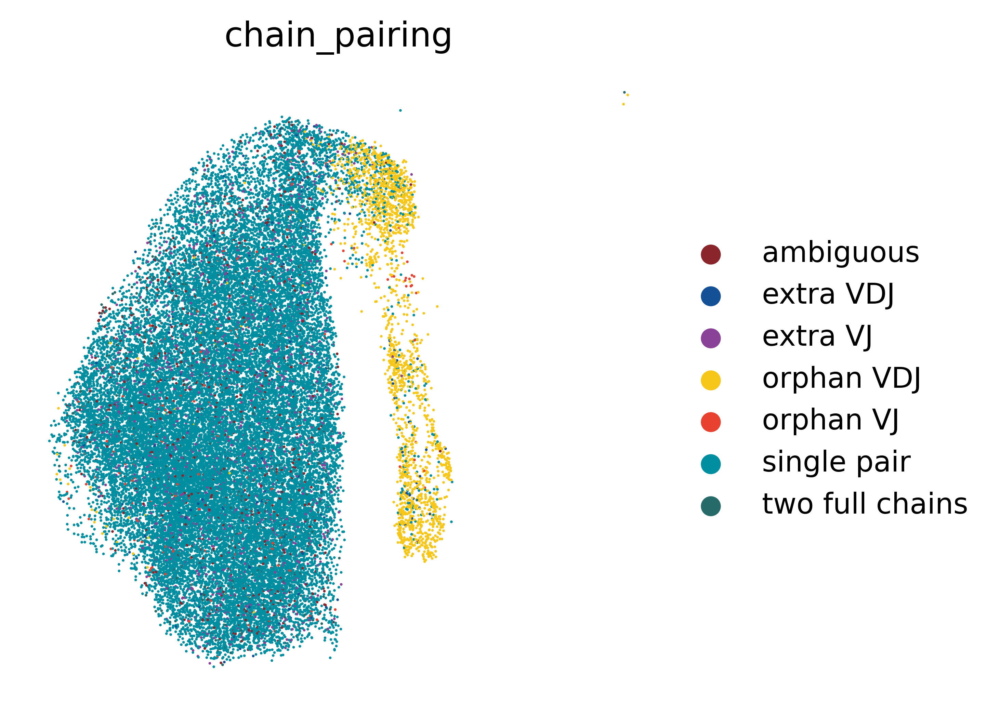

In [46]:
sc.pl.umap(adata1_IR, color="chain_pairing",frameon=False,show=False)
plt.savefig("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure5/Figure5C_chain_pairing_Organ.pdf",bbox_inches='tight')

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. P

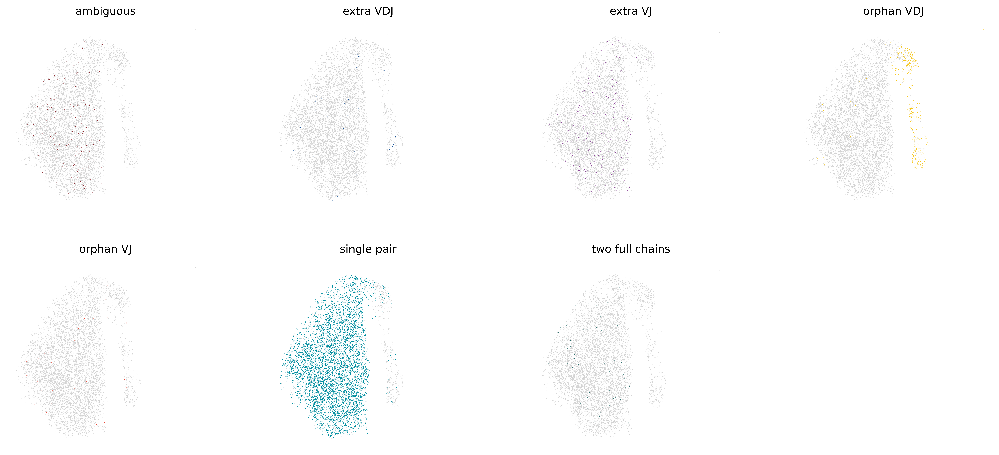

In [47]:
cluster_small_multiples(adata1_IR,"chain_pairing",size=0.5)
plt.savefig("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure5/Figure5C_chain_pairing_Organ_split.pdf")

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


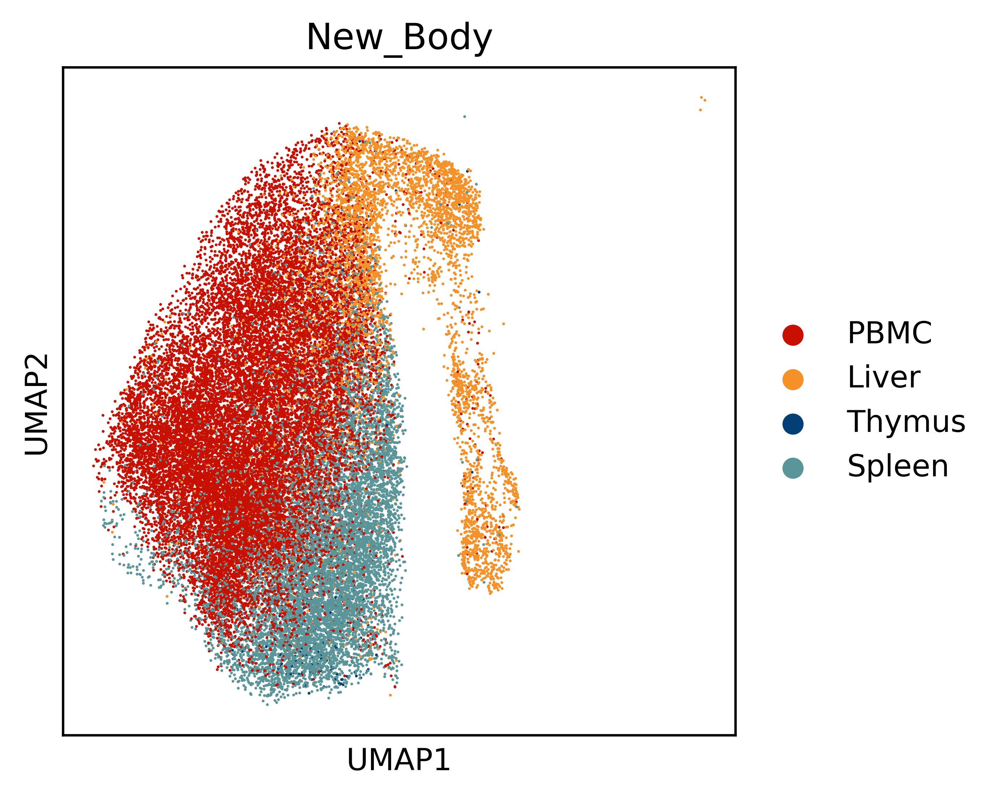

In [48]:
import pandas as pd

adata1_IR.obs['New_Body'] = pd.Categorical(adata1_IR.obs['New_Body'], 
                                        categories=["PBMC", "Liver", "Thymus", "Spleen"], 
                                        ordered=True)

sc.pl.umap(adata1_IR, color='New_Body', palette=['#C71000FF',"#f49128","#023f75","#5A9599FF"],show=False)
plt.savefig("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure5/Figure5C_Organ.pdf",bbox_inches='tight')

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


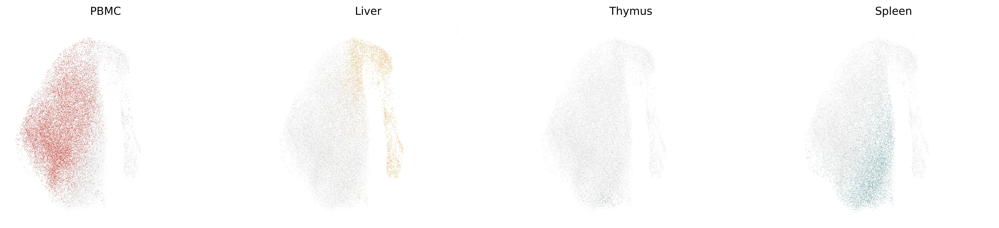

In [49]:
cluster_small_multiples(adata1_IR,"New_Body",size=0.5)

plt.savefig("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Main_Figure5/Figure5C_Organ_split.pdf")

In [50]:
def create_palette(cell_types, colors):
    cell_type_colors = {}
    for i, cell_type in enumerate(cell_types):
        color = colors[i % len(colors)]
        cell_type_colors[cell_type] = color
    return cell_type_colors
colorname2=["#46A040" ,"#00AF99", "#FFC179" ,"#98D9E9" ,"#F6313E", "#FFA300", "#333366", "#FF5A00", "#663366","#FF6666",
"#8F1336", "#0081C9", "#001588", "#CC0033","#CC9966","#CC0033","#999933","#009966","#CCCC33","#CCFF99","#333399","#993333",
"#490C65", "#BA7FD0","#A6CEE3", "#1F78B4", "#DE77AE", "#B2DF8A", "#006D2C", "#868686", "#B5AD64","#9DA8E2","#91C392","#FF9900","#339966"]

In [51]:
adata=adata1[adata1.obs['chain_pairing'].isin(['single pair','extra VJ','extra VDJ'])]

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'chain_pairing'}, xlabel='UMAP1', ylabel='UMAP2'>

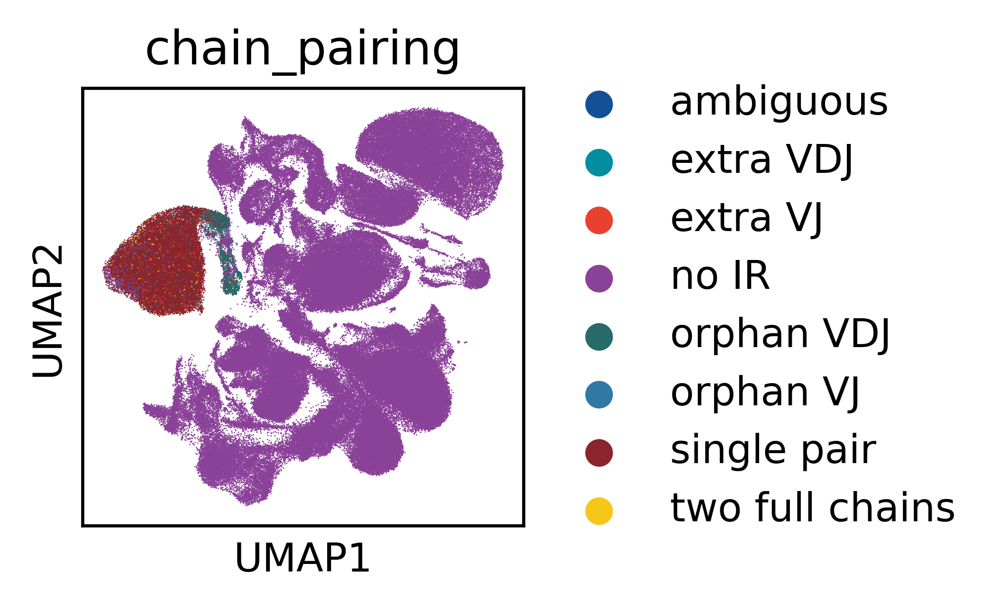

In [52]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata1, color=["chain_pairing"],palette= create_palette(adata1.obs["chain_pairing"].unique(),col11),show=False)

In [53]:

df1 = ir.tl.spectratype(adata, target_col="AdjustedID",groupby='IR_VDJ_1_junction_aa')

df_sums1 = df1.sum(axis=0)
df_sums_ratio1 = df1.div(df_sums1, axis=1)



In [54]:
adata1

AnnData object with n_obs × n_vars = 245834 × 31424
    obs: 'Name', 'doublet_scores', 'predicted_doublets', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Cellname', 'AdjustedID', 'New_Body', 'Week', 'TCRBCRlabel', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Last_cell_type', 'Cell_lineage', 'Last_cell_type2', 'Last_cell_type_num', 'Last_cell_type_num2', 'is_cell', 'high_confidence', 'multi_chain', 'extra_chains', 'IR_VJ_1_c_call', 'IR_VJ_2_c_call', 'IR_VDJ_1_c_call', 'IR_VDJ_2_c_call', 'IR_VJ_1_consensus_count', 'IR_VJ_2_consensus_count', 'IR_VDJ_1_consensus_count', 'IR_VDJ_2_consensus_count', 'IR_VJ_1_d_call', 'IR_VJ_2_d_call', 'IR_VDJ_1_d_call', 'IR_VDJ_2_d_call', 'IR_VJ_1_duplicate_count', 'IR_VJ_2_duplicate_count', 'IR_VDJ_1_duplicate_count', 'IR_VDJ_2_duplicate_count', 'IR_VJ_1_j_call', 'IR_VJ_2_j_call', 'IR_VDJ_1_j_call', 'IR_VDJ_2_j_call', 'IR_VJ_1_junction', 'IR_VJ_2_junction', 'IR_VDJ_1_junction', 'I

In [55]:
adata1

AnnData object with n_obs × n_vars = 245834 × 31424
    obs: 'Name', 'doublet_scores', 'predicted_doublets', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Cellname', 'AdjustedID', 'New_Body', 'Week', 'TCRBCRlabel', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Last_cell_type', 'Cell_lineage', 'Last_cell_type2', 'Last_cell_type_num', 'Last_cell_type_num2', 'is_cell', 'high_confidence', 'multi_chain', 'extra_chains', 'IR_VJ_1_c_call', 'IR_VJ_2_c_call', 'IR_VDJ_1_c_call', 'IR_VDJ_2_c_call', 'IR_VJ_1_consensus_count', 'IR_VJ_2_consensus_count', 'IR_VDJ_1_consensus_count', 'IR_VDJ_2_consensus_count', 'IR_VJ_1_d_call', 'IR_VJ_2_d_call', 'IR_VDJ_1_d_call', 'IR_VDJ_2_d_call', 'IR_VJ_1_duplicate_count', 'IR_VJ_2_duplicate_count', 'IR_VDJ_1_duplicate_count', 'IR_VDJ_2_duplicate_count', 'IR_VJ_1_j_call', 'IR_VJ_2_j_call', 'IR_VDJ_1_j_call', 'IR_VDJ_2_j_call', 'IR_VJ_1_junction', 'IR_VJ_2_junction', 'IR_VDJ_1_junction', 'I

In [56]:
adata

View of AnnData object with n_obs × n_vars = 31502 × 31424
    obs: 'Name', 'doublet_scores', 'predicted_doublets', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Cellname', 'AdjustedID', 'New_Body', 'Week', 'TCRBCRlabel', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Last_cell_type', 'Cell_lineage', 'Last_cell_type2', 'Last_cell_type_num', 'Last_cell_type_num2', 'is_cell', 'high_confidence', 'multi_chain', 'extra_chains', 'IR_VJ_1_c_call', 'IR_VJ_2_c_call', 'IR_VDJ_1_c_call', 'IR_VDJ_2_c_call', 'IR_VJ_1_consensus_count', 'IR_VJ_2_consensus_count', 'IR_VDJ_1_consensus_count', 'IR_VDJ_2_consensus_count', 'IR_VJ_1_d_call', 'IR_VJ_2_d_call', 'IR_VDJ_1_d_call', 'IR_VDJ_2_d_call', 'IR_VJ_1_duplicate_count', 'IR_VJ_2_duplicate_count', 'IR_VDJ_1_duplicate_count', 'IR_VDJ_2_duplicate_count', 'IR_VJ_1_j_call', 'IR_VJ_2_j_call', 'IR_VDJ_1_j_call', 'IR_VDJ_2_j_call', 'IR_VJ_1_junction', 'IR_VJ_2_junction', 'IR_VDJ_1_juncti

In [57]:
adata.write_h5ad("./All_scanpyData/Data/Scanpy_lastCell_BCRall.h5ad")

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
